<a href="https://colab.research.google.com/github/Cordier-Info/exemples/blob/master/multpoly.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Polynômes et FFT

In [ ]:
from time import time
import matplotlib.pyplot as plt
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (20, 15)

### Représentation d'un polynôme par ses coefficients

Un polynôme $P(x)=a_n x^n+a_{n-1}x^{n-1}+\cdots + a_1 x+a_0$ de degré $n$ peut être représenté par la liste `L` ordonnée de ses $n+1$ coefficients $a_i$ de manière à ce que `L[i]`$=a_i$. 


Exemple : $ 5x^7+3x^5-2x^2+x\Leftrightarrow $ `[0,1,-2,0,0,3,0,5]`

## Estimation de la valeur d'un polynôme en un point

### Méthode naïve

$$P(x_0)=\sum_{i=0}^n a_ix^i$$
Écrire le plus directement possible un code implémentant la formule.

In [ ]:
def estimNaive(a,x0) :
  P = 0
  for i in range(len(a)) :
    P += a[i]*x0**i
  return P

> Complexité ?

In [ ]:
a = [1,-1,1]
estimNaive(a,2)

3

### Méthode de Horner

Méthode de Horner pour calculer efficacement la valeur d'un polynôme en $x_0$ permet de [réduire le nombre de multiplications nécessaires à son minimum](https://fr.wikipedia.org/wiki/Méthode_de_Ruffini-Horner).
On écrit que :
$$P(x_0)= ((\ldots((a_n x_0 + a_{n-1})x_0+a_{n-2})x_0+\ldots)x_0+a_1)x_0+a_0$$

> Combien de multiplications faut-il ?

In [ ]:
def estimHorner(a,x0) :
  n = len(a)
  P = a[-1]
  for i in range(n-1) :
    P = P*x0+a[n-2-i]
  return P

In [ ]:
a = [1,-1,1]
estimHorner(a,2)

3

### Tracer d'un polynôme

In [ ]:
def tracePoly(a,limites) :
  nbPts =1000
  X = [limites[0] + (limites[1]-limites[0])/nbPts*i for i in range(nbPts+1)]
  Y = [estimHorner(a,x) for x in X]
  plt.plot(X,Y)

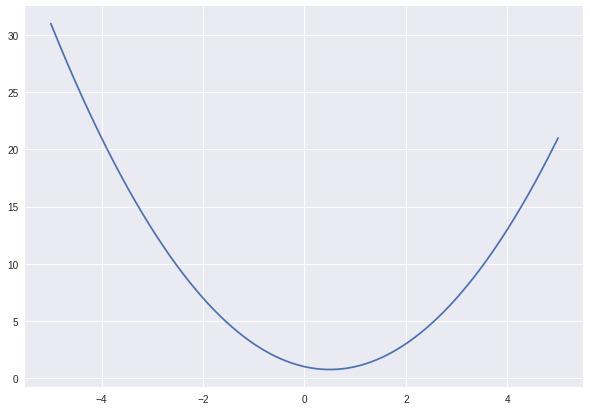

In [ ]:
tracePoly(a,(-5,5))

### Comparaison Horner - Naïve

Pour comparer la méthode de Horner à la méthode d'évaluation naïve :

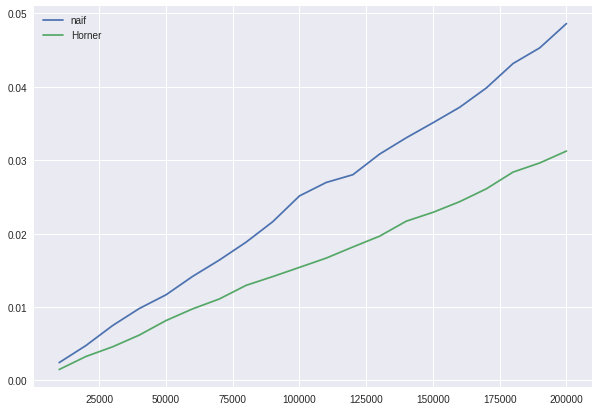

In [ ]:
from time import time
from random import randint

N = [i for i in range(10000,210000,10000)]
Tnaif = []
THorner = []
x0 = 0.8
M = 40
for n in N :
  a = [1 for i in range(n)]
  S = 0
  for i in range(M) :
    start = time()
    estimNaive(a,x0)
    stop = time()
    S += stop - start
  Tnaif.append(S/M)
  S = 0
  for i in range(M) :
    start = time()
    estimHorner(a,x0)
    stop = time()
    S += stop-start
  THorner.append(S/M)
plt.plot(N,Tnaif,label="naif")
plt.plot(N,THorner,label="Horner")
plt.legend()

In [ ]:
THorner

[0.001491677761077881,
 0.0032620787620544433,
 0.004582452774047852,
 0.0061802446842193605,
 0.008157831430435181,
 0.009753495454788208,
 0.011102157831192016,
 0.012953436374664307,
 0.014150053262710571,
 0.015403288602828979,
 0.01666414737701416,
 0.018182122707366945,
 0.019651663303375245,
 0.02169607877731323,
 0.022899931669235228,
 0.024353331327438353,
 0.026107966899871826,
 0.028381925821304322,
 0.029629987478256226,
 0.03124796748161316]

## Quotient d'un polynôme par $(x-x_0)$

La division euclidienne de $P(x)=a_n x^n+a_{n-1}x^{n-1}+\cdots + a_1 x+a_0$ par $(x-x_0)$ donne $P(x) = (x-x_0)Q(x) + P(x_0)$ où $Q$ est un polynome de degré $n-1$.<br>
En écrivant $Q(x)=q_{n-1} x^{n-1}+q_{n-2}x^{n-2}+\cdots + q_1 x+q_0$ et en identifiant les coefficients de même degré dans les deux membres, on obtient :<br>
$
\begin{aligned}
q_{n-1} &= a_n\\
q_{k-1}-q_k x_0 &= a_k \text{ pour tout cas tel que } 0<k<n 
\end{aligned}
$<br>
Soit encore<br>
$q_{k-1} = q_k x_0 + a_k$<br>
Les $n$ valeurs de la suite $q$ calculées ici sont précisément les $n$ valeurs successives calculées pour évaluer $P(x_0)$ avec la méthode de Horner.

In [ ]:
def division(a,x0) :
  n = len(a)
  Q = []
  P = a[-1]
  Q.append(P)
  for i in range(n-2) :
    P = P*x0+a[n-2-i]
    Q.append(P)
  P = P*x0+a[0]
  return Q,P

In [ ]:
division([-5,3,-7,4],2)

([4, 1, 5], 5)

## Multiplication de deux polynômes

$C(x)=A(x)\times B(x)$

#### Algorithme naïf sur la représentation par coefficient :

$c_k = \sum_{i+j=k}a_ib_j$

In [ ]:
def prodcoef(a,b) :
  na = len(a)-1
  nb = len(b)-1
  c = [0 for i in range(na+nb+1)]
  for i in range(na+1) :
    for j in range(nb+1) :
      c[i+j] += a[i]*b[j]
  return c

In [ ]:
a1 = [1,1,0,1]
a2 = [1,0,0,1]
prodcoef(a1,a2)

[1, 1, 0, 2, 1, 0, 1]

> Complexité ?

#### Représentation par points :

$\{(x_0,y_0),(x_1,y_1),\ldots,(x_{n},y_{n})\}$ où $y_i = P(x_i)$

$\begin{pmatrix}
 1     & x_0 &   & x_0^2 & \cdots & x_0^n  \\
 1     & x_1  &  & x_1^2 & \cdots & x_1^n  \\
 \vdots & \vdots& &\vdots & \ddots & \vdots \\
 1     & x_n   & & x_n^2 & \cdots & x_n^n  
\end{pmatrix}
\begin{pmatrix}
\vphantom{x_0^n}a_0 \\
\vphantom{x_0^n}a_1 \\
\vdots \\
\vphantom{x_0^n}a_n 
\end{pmatrix}$

#### Multiplication à partir de la représentation par points :

Si on fait le produit entre deux polynômes de degré $n$ (si ce n'est pas le cas, on complète le plus petit par des zéros), le résultat sera de degré $2n$.<br>
Donc même si une représentation par $n$ points différents de chaque polynôme est suffisante, il faudra $2n$ points pour interpoler le polynôme produit.<br>
On utilise alors une représentation par point étendue à $2n$ points pour chaque polynôme.<br>
Supposons donc que $P_1$ soit représenté par $\{(x_0,y_0),(x_1,y_1),\ldots,(x_{2n-1},y_{2n-1})\}$ et $P_2$ par $\{(x_0,y'_0),(x_1,y'_1),\ldots,(x_{2n-1},y'_{2n-1})\}$, alors une représentation par points de $P_1\times P_2$ sera $\{(x_0,y_0y'_0),(x_1,y_1y'_1),\ldots,(x_{2n-1},y_{2n-1}y'_{2n-1})\}$

In [ ]:
def multPts(y1,y2) :
  """
  y1 et y2 de taille 2n
  """
  yProd = []
  for i in range(len(y1)) :
    yProd.append(y1[i]*y2[i])
  return yProd

In [ ]:
def multPts2(ptsA,ptsB):
  """
  ptsA et ptsB de taille 2n
  """
  x,yA = zip(*ptsA)
  _,yB = zip(*ptsB)
  ptC = []
  for i in range(len(ptsA)):
    ptC.append((x[i],yA[i]*yB[i]))
  return ptC

In [ ]:
ptsA = [(1,2),(2,2),(3,4),(2,1)]
ptsB = [(1,2),(2,2),(3,4),(2,1)]
multPts2(ptsA,ptsB)

[(1, 4), (2, 4), (3, 16), (2, 1)]

### Racines de l'unité

In [ ]:
from matplotlib import rc
rc('animation', html='jshtml')

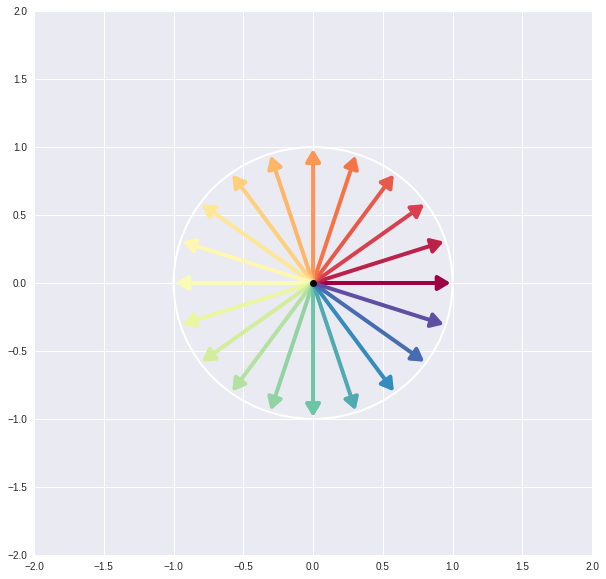

In [ ]:
import matplotlib.animation as animation
from math import pi,cos,sin
fig, ax = plt.subplots(figsize=(10,10))#,frameon=False)
#ax.axis('off')
#cmap = plt.get_cmap("tab10")
#cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']

n = 20
cmap=plt.cm.get_cmap('Spectral', n)
a = [1 for i in range(n)]
dx = [0 for i in range(n)]
dy = dx[:]
centrex = [0 for i in range(n)]
centrey = centrex[:]
finx = centrex[:]
finy = centrey[:]
nbframes = 50

def frame(dt):
  global nbframes, n
  for i in range(n) :
    dx[i] = a[i]*cos(2*pi/n*i)
    dy[i] = a[i]*sin(2*pi/n*i)
  for i in range(1,n) :
    centrex[i] = centrex[i-1] + dx[i-1]
    finx[i] = dx[i]+centrex[i]*dt/nbframes
    finy[i] = dy[i]+centrey[i]*dt/nbframes
    centrey[i] = centrey[i-1] + dy[i-1]
  M = max(finx+[2]+finy)
  ax.clear()
  ax.set_xlim([-M, M])
  ax.set_ylim([-M, M])
  ax.annotate('', xy=(dx[0],dy[0]), xytext=(0,0),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(0)))
  for i in range(1,n) :
    ax.annotate('', xy=(finx[i],finy[i]), xytext=(centrex[i]*dt/nbframes,centrey[i]*dt/nbframes),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(i)))#cycle[i%(len(cycle))]))
  ax.plot(0,0,'ko',zorder=n)
  cercle = plt.Circle((0,0),1,fill=False,lw=2,color="w")
  ax.add_patch(cercle)

anim = animation.FuncAnimation(fig, frame, frames=nbframes, interval=20, blit=False, repeat=False)
#anim.save('basic_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

In [ ]:
anim

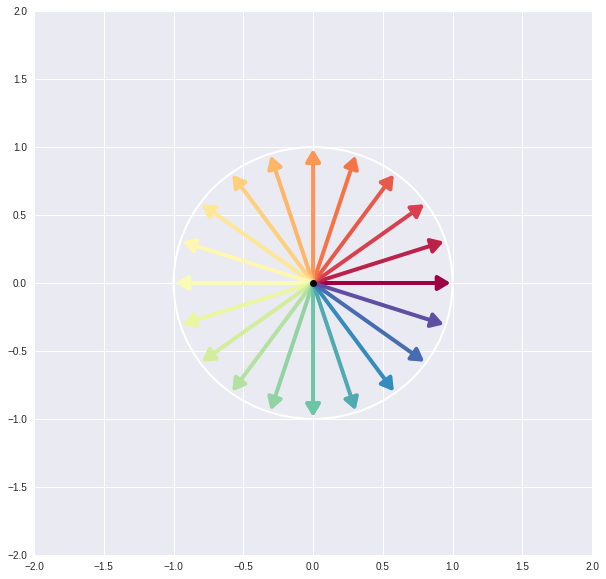

In [ ]:
import matplotlib.animation as animation
from math import pi,cos,sin
fig, ax = plt.subplots(figsize=(10,10))#,frameon=False)

n = 20
cmap=plt.cm.get_cmap('Spectral', n)
a = [1 for i in range(n)]
dx = [0 for i in range(n)]
dy = dx[:]
centrex = [0 for i in range(n)]
centrey = centrex[:]
finx = centrex[:]
finy = centrey[:]
nbframes = 50

def frame(dt):
  global nbframes, n
  for i in range(n) :
    dx[i] = a[i]*cos(2*pi/n*i*(1+dt/nbframes))
    dy[i] = a[i]*sin(2*pi/n*i*(1+dt/nbframes))
  for i in range(1,n) :
    finx[i] = dx[i]+centrex[i]*dt/nbframes
    finy[i] = dy[i]+centrey[i]*dt/nbframes
  M = max(finx+[2]+finy)
  ax.clear()
  ax.set_xlim([-M, M])
  ax.set_ylim([-M, M])
  ax.annotate('', xy=(dx[0],dy[0]), xytext=(0,0),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(0)))
  for i in range(1,n) :
    ax.annotate('', xy=(finx[i],finy[i]), xytext=(centrex[i]*dt/nbframes,centrey[i]*dt/nbframes),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(i)))#cycle[i%(len(cycle))]))
  ax.plot(0,0,'ko',zorder=n)
  cercle = plt.Circle((0,0),1,fill=False,lw=2,color="w")
  ax.add_patch(cercle)

anim = animation.FuncAnimation(fig, frame, frames=nbframes+1, interval=20, blit=False, repeat=False)
#anim.save('basic_animation.mp4', fps=30, extra_args=['-vcodec', 'libx264'])

In [ ]:
anim

In [ ]:
from time import time
import matplotlib.pyplot as plt
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (10, 7)

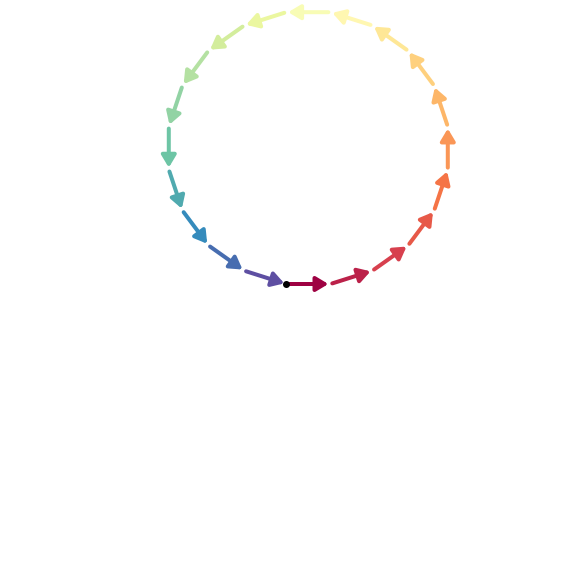

In [ ]:
from math import pi,cos,sin
fig, ax = plt.subplots(figsize=(10,10))#,frameon=False)
ax.axis('off')
#cmap = plt.get_cmap("tab10")
#cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']

n = 20
cmap=plt.cm.get_cmap('Spectral', n)
a = [1 for i in range(n)]
dx = [0 for i in range(n)]
dy = dx[:]
centrex = [0 for i in range(n)]
centrey = centrex[:]
finx = centrex[:]
finy = centrey[:]
nbframes = 100
compt = 0
for k in range(nbframes+1):
  for i in range(n) :
    dx[i] = a[i]*cos(2*pi/n*i)
    dy[i] = a[i]*sin(2*pi/n*i)
  for i in range(1,n) :
    centrex[i] = centrex[i-1] + dx[i-1]
    finx[i] = dx[i]+centrex[i]*k/nbframes
    finy[i] = dy[i]+centrey[i]*k/nbframes
    centrey[i] = centrey[i-1] + dy[i-1]
  M = max(finx+[2]+finy)
  ax.clear()
  ax.axis('off')
  ax.set_xlim([-M, M])
  ax.set_ylim([-M, M])
  ax.annotate('', xy=(dx[0],dy[0]), xytext=(0,0),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(0)))
  for i in range(1,n) :
    ax.annotate('', xy=(finx[i],finy[i]), xytext=(centrex[i]*k/nbframes,centrey[i]*k/nbframes),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(i)))#cycle[i%(len(cycle))]))
  ax.plot(0,0,'ko',zorder=n)
  cercle = plt.Circle((0,0),1,fill=False,lw=2,color="w")
  ax.add_patch(cercle)
  fig.savefig(f"film/{compt:04}.png",dpi=200,transparent=True,bbox_inches = 'tight',pad_inches = 0)
  compt += 1

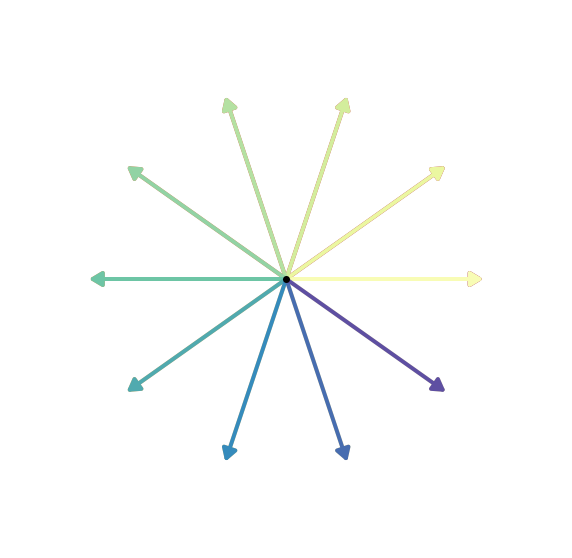

In [ ]:
from math import pi,cos,sin
fig, ax = plt.subplots(figsize=(10,10))#,frameon=False)
ax.axis('off')

n = 20
cmap=plt.cm.get_cmap('Spectral', n)
a = [1 for i in range(n)]
dx = [0 for i in range(n)]
dy = dx[:]
centrex = [0 for i in range(n)]
centrey = centrex[:]
finx = centrex[:]
finy = centrey[:]
nbframes = 200
compt = 0
for k in range(nbframes+1):
  for i in range(n) :
    dx[i] = a[i]*cos(2*pi/n*i*(1+k/nbframes))
    dy[i] = a[i]*sin(2*pi/n*i*(1+k/nbframes))
  for i in range(1,n) :
    finx[i] = a[i]*cos(2*pi/n*i*(1+k/nbframes))
    finy[i] = a[i]*sin(2*pi/n*i*(1+k/nbframes))
  M = max(finx+[1.4]+finy)
  ax.clear()
  ax.axis('off')
  ax.set_xlim([-M, M])
  ax.set_ylim([-M, M])
  ax.annotate('', xy=(dx[0],dy[0]), xytext=(0,0),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(0)))
  for i in range(1,n) :
    ax.annotate('', xy=(finx[i],finy[i]), xytext=(centrex[i]*k/nbframes,centrey[i]*k/nbframes),arrowprops=dict(arrowstyle= '-|>,head_width=0.6,head_length=1',lw=4,ls='-',color=cmap(i)))#cycle[i%(len(cycle))]))
  ax.plot(0,0,'ko',zorder=n)
  cercle = plt.Circle((0,0),1,fill=False,lw=2,color="w")
  ax.add_patch(cercle)
  fig.savefig(f"film2/{compt:04}.png",dpi=200,transparent=True,bbox_inches = 'tight',pad_inches = 0.5)
  compt += 1

## FFT et FFT inverse

In [2]:
from math import e,pi

def FFT(a,n) :
  """
  n est une puissance de 2
  """
  if n == 1 :
    return a
  ypair = FFT(a[::2],n//2)
  yimp = FFT(a[1::2],n//2)
  y = [0 for i in range(n)]
  w = 1
  wn = e**(pi/n*2j)
  for k in range(n//2) :
    t = w*yimp[k]
    y[k] = ypair[k] + t
    y[k+n//2] = ypair[k] - t
    w = w*wn
  return y

In [3]:
def FFTinv(y,n,N=None):
  """
  n est une puissance de 2
  N devra valoir n lors du premier appel
  """
  if n == 1:
    return y
  apair = FFTinv(y[::2],n//2)
  aimp = FFTinv(y[1::2],n//2)
  a = [0 for i in range(n)]
  wn = e**(-pi/n*2j)
  w = 1
  for k in range(n//2):
    t = w*aimp[k]
    a[k] = (apair[k] + t)
    a[k+n//2] = (apair[k] - t)
    w = w*wn
  if n == N:
    for i in range(N):
      a[i] /= n
  return a

In [ ]:
def completePuiss2(n):
  puiss2 = len(bin(n))-2
  if 2**(puiss2-1) == n :
    cible = 2**(puiss2-1)
  else : 
    cible = 2**puiss2
  return cible

In [ ]:
def prodFFT(a1,a2) :
  lfin = len(a1)+len(a2)-1
  l = max(len(a1),len(a2))
  n = completePuiss2(l)
  a1 = a1 + (2*n-len(a1))*[0]
  a2 = a2 + (2*n-len(a2))*[0]
  Z = FFTinv(multPts(FFT(a1,2*n),FFT(a2,2*n)),2*n,2*n)
  prod = [round(z.real) for z in Z]
  return prod[:lfin]

### Tests et comparaisons

In [ ]:
a1 = [1,1,1,1]
a2 = [5,6,7,8]

In [ ]:
prodcoef(a1,a2)

[5, 11, 18, 26, 21, 15, 8]

In [ ]:
prodFFT(a1,a2)

[5, 11, 18, 26, 21, 15, 8]

In [ ]:
A = FFT(a1+len(a1)*[0],8)
print(A)

[4, (1+2.414213562373095j), 0j, (1.0000000000000004+0.4142135623730949j), 0, (0.9999999999999999-0.4142135623730949j), 0j, (0.9999999999999994-2.414213562373095j)]


In [ ]:
FFTinv(A,8,8)

[(1+0j),
 (0.9999999999999999-2.7755575615628914e-17j),
 (1+1.1102230246251565e-16j),
 (1+5.551115123125783e-17j),
 0j,
 (1.1102230246251565e-16+2.7755575615628914e-17j),
 -1.1102230246251565e-16j,
 -5.551115123125783e-17j]

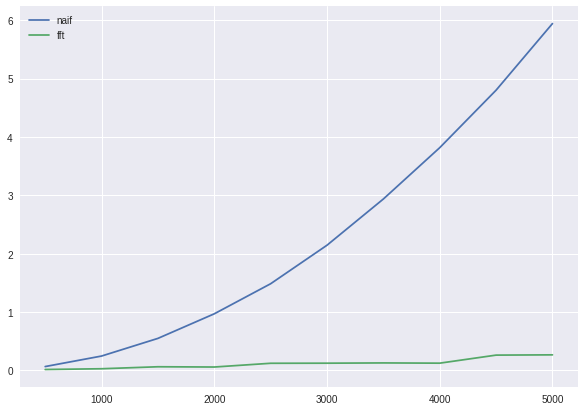

In [ ]:
from time import time
from random import randint

N = [500*i for i in range(1,11)]
Tnaif = []
Tfft = []

for n in N :
  a1 = [randint(-10,10) for i in range(n)]
  a2 = [randint(-10,10) for i in range(n)]
  a11 = a1[:]
  a22 = a2[:]
  start = time()
  Cnaif = prodcoef(a1,a2)
  stop = time()
  Tnaif.append(stop-start)
  start = time()
  Cfft = prodFFT(a11,a22)
  stop = time()
  Tfft.append(stop-start)
  start = time()
plt.plot(N,Tnaif,label="naif")
plt.plot(N,Tfft,label="fft")
plt.legend()

In [ ]:
print(Tnaif)
print(Tfft)
print(N)

[0.06764554977416992, 0.24354958534240723, 0.5502855777740479, 0.9646189212799072, 1.5063390731811523, 2.123750686645508, 2.9499831199645996, 3.7936208248138428, 4.831254243850708, 5.951016664505005]
[0.012761116027832031, 0.029345035552978516, 0.05803060531616211, 0.05799674987792969, 0.1250154972076416, 0.12250542640686035, 0.1224524974822998, 0.13180184364318848, 0.26471471786499023, 0.2648332118988037]
[500, 1000, 1500, 2000, 2500, 3000, 3500, 4000, 4500, 5000]


In [ ]:
from random import randint
n = 7
a1 = [randint(-10,10) for i in range(n)]
a2 = [randint(-10,10) for i in range(n)]
a11 = a1[:]
a22 = a2[:]
Cnaif = prodcoef(a1,a2)
Cfft = prodFFT(a11,a22)

In [ ]:
Cnaif

[-30, 2, 13, 8, -50, -17, 85, -25, -106, -115, 45, 50, 0]

In [ ]:
Cfft

[-30, 2, 13, 8, -50, -17, 85, -25, -106, -115, 45, 50, 0]

### Applications FFT

#### Audio

In [4]:
import matplotlib.pyplot as plt
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (10, 7)
from math import cos,sin,pi
import librosa
import IPython.display as ipd
import plotly.express as px

In [5]:
f = 440
N = 2**16
nb_T = 500
T = [i/N*nb_T/f for i in range(1,N+1)]
signal = [sum([sin(2*pi*f*t*(2*i+1))/(2*i+1) for i in range(20)]) for t in T]
TFDsignal = FFT(signal,N)

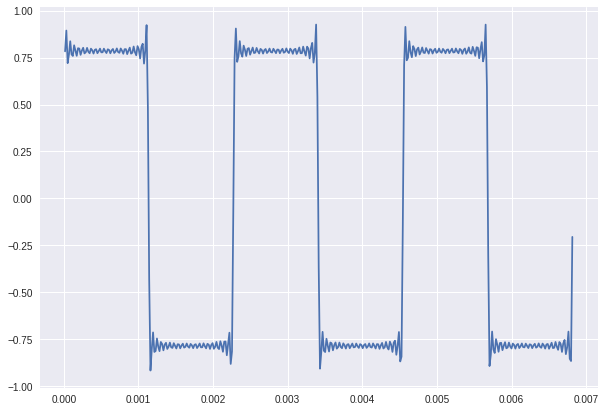

In [6]:
plt.plot(T[:N//nb_T*3],signal[:N//nb_T*3])

In [ ]:
ipd.Audio(signal, rate=N/(nb_T/f))

In [7]:
TFDsignal = [abs(z.real) for z in TFDsignal]

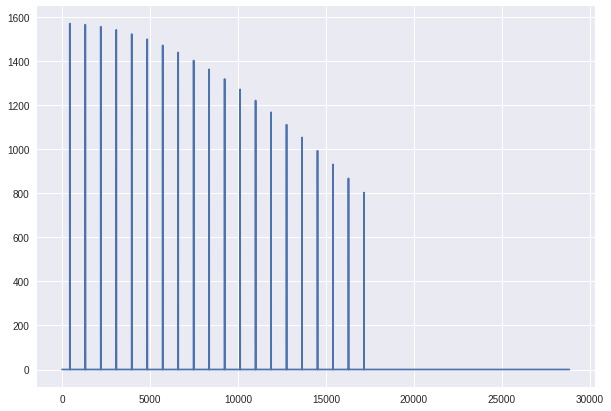

In [8]:
F = [i*f/nb_T for i in range(N)]
plt.plot(F[:N//2],TFDsignal[:N//2])

In [ ]:
px.line(x=F,y=TFDsignal)

65536
65536


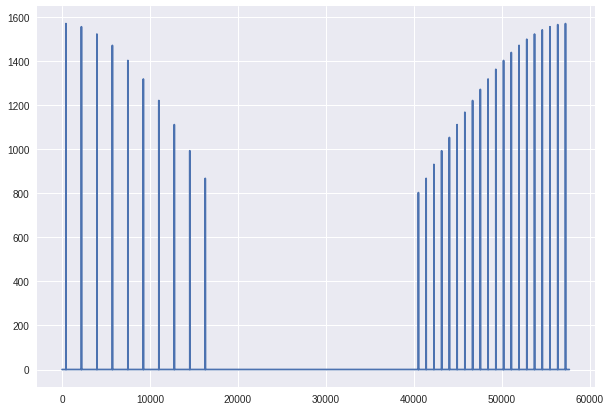

In [ ]:
print(len(TFDsignal))
for i in range(1,20,2) :
  TFDsignal[(2*i+1)*nb_T-10:(2*i+1)*nb_T+10]=[0]*20
print(len(TFDsignal))
F = [i*f/nb_T for i in range(N)]
plt.plot(F,TFDsignal)

In [ ]:
signalFiltre = FFTinv(TFDsignal,N,N)

In [ ]:
signalFiltre = [z.real for z in signalFiltre]

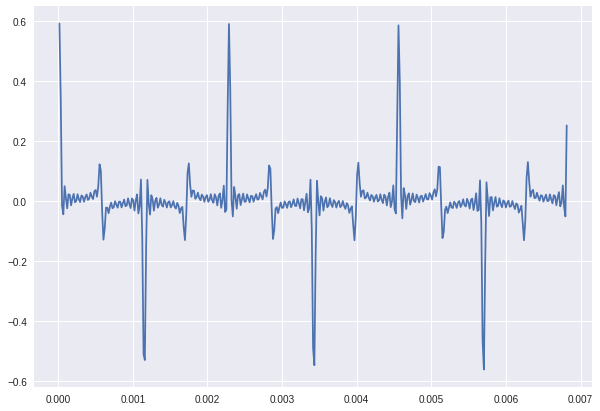

In [ ]:
plt.plot(T[:N//nb_T*3],signalFiltre[:N//nb_T*3])

In [ ]:
ipd.Audio(signalFiltre, rate=N/(nb_T/f))

In [ ]:
f2 = 440
f1 = int(round(f2*2/3))
f3 = int(round(f2*3//2))
N = 2**16
nb_T = 500
T = [i/N*nb_T/f2 for i in range(1,N+1)]
F = [i*f/nb_T for i in range(N)]
signal = [sin(2*pi*f2*t)+0.5*sin(2*pi*f1*t)+0.2*sin(2*pi*f3*t) for t in T]
TFDsignal = FFT(signal,N)

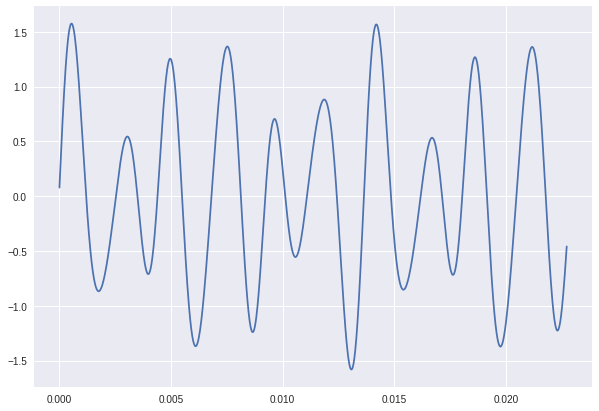

In [ ]:
plt.plot(T[:N//nb_T*10],signal[:N//nb_T*10])

In [ ]:
ipd.Audio(signal, rate=N/(nb_T/f))

In [ ]:
TFDsignal = [abs(z.real) for z in TFDsignal]

In [ ]:
px.line(x=F[:N//32],y=TFDsignal[:N//32])

In [ ]:
TFDsignal[nb_T-10:nb_T+10]=[0]*20
TFDsignal[-nb_T-10:-nb_T+10]=[0]*20
TFDsignal[int(round(nb_T*3/2))-10:int(round(nb_T*3/2))+10]=[0]*20
TFDsignal[-int(round(nb_T*3/2))-10:-int(round(nb_T*3/2))+10]=[0]*20

In [ ]:
px.line(x=F[:N//32],y=TFDsignal[:N//32])

In [ ]:
signalFiltre = FFTinv(TFDsignal[:N],N,N)
signalFiltre = [z.real for z in signalFiltre]

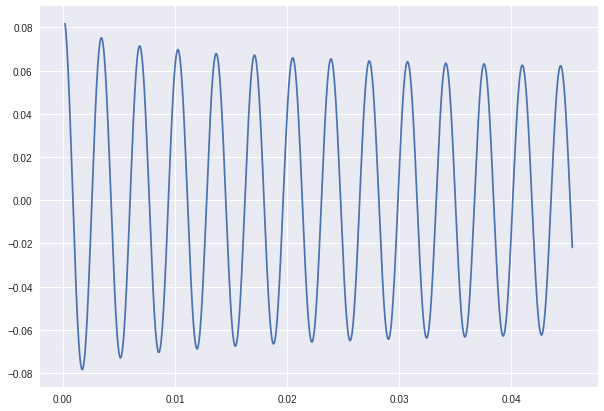

In [ ]:
plt.plot(T[10:N//nb_T*20],signalFiltre[10:N//nb_T*20])

In [ ]:
ipd.Audio(signalFiltre, rate=N/(nb_T/f))

#### Images

In [ ]:
from PIL import Image
import urllib.request # pour récupérer une image sur le web
from IPython.display import display # pour afficher dans un notebook
import numpy as np

In [ ]:
opener=urllib.request.build_opener()
opener.addheaders=[('User-Agent','Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/36.0.1941.0 Safari/537.36')]
urllib.request.install_opener(opener) # sans ce bazar, certains sites refusent la visite car le fouineur se présente pas comme un browser
url = "https://blog-www.pods.com/wp-content/uploads/2019/04/MG_1_1_New_York_City-1.jpg"
urllib.request.urlretrieve(url, 'NY')
image = Image.open('NY')

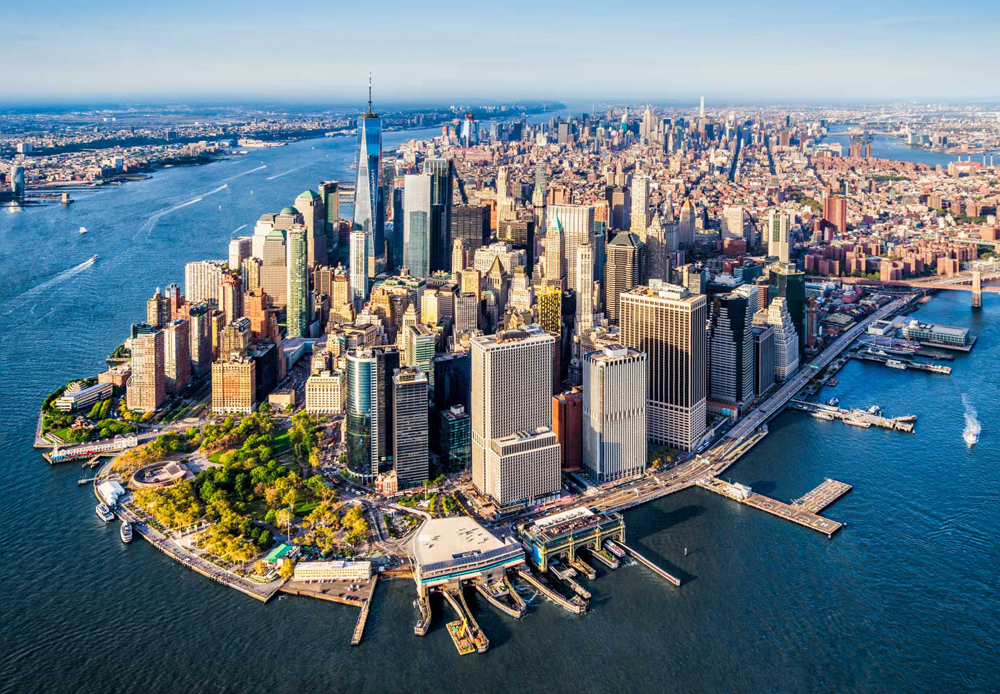

In [ ]:
image

Ne gardons qu'un seul canal couleur :

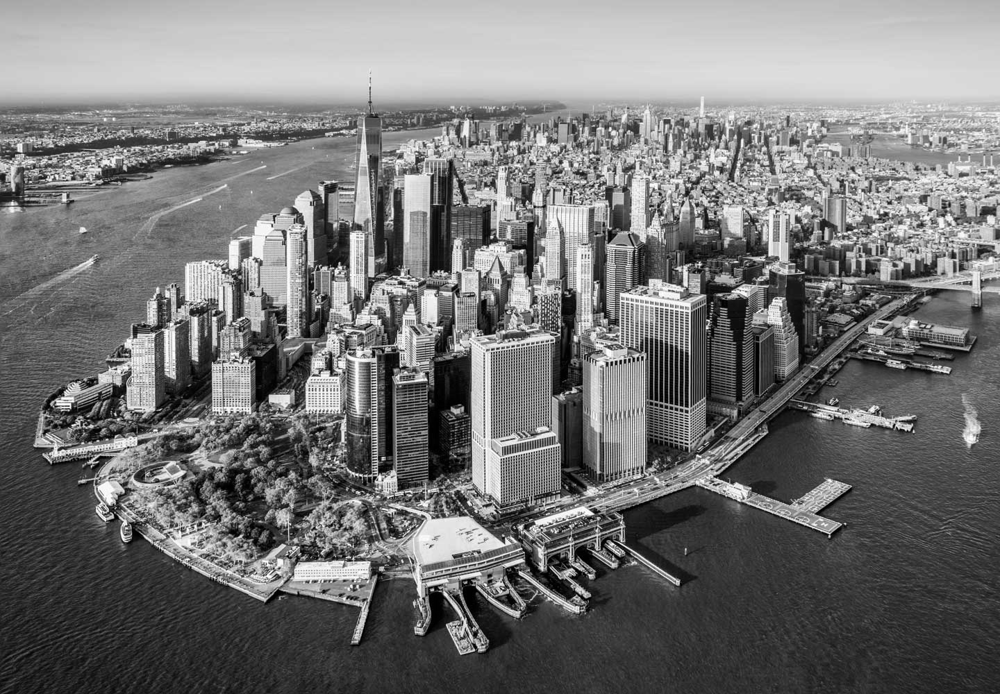

In [ ]:
imageG = image.convert("L")
imageG

In [ ]:
image_np = np.array(imageG)[100:100+2**9,200:200+2**10]
H,L = image_np.shape
print(H,L)

512 1024


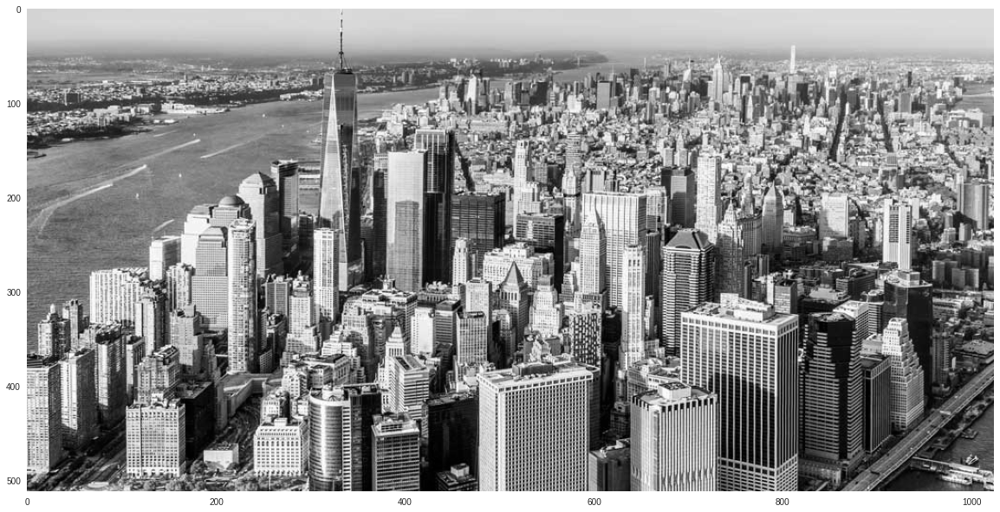

In [ ]:
plt.imshow(image_np,cmap='gray', vmin=0, vmax=255)
plt.grid(None)

Pour une DFT à deux dimensions, il faut d'abord faire une DFT sur les lignes puis une DFT du résultat sur les colonnes :

In [ ]:
def centrage(image):
  H, L = image.shape
  Hmil = H // 2
  Lmil = L // 2
  haut = image[:Hmil, :]
  bas = image[Hmil:, :]
  image = np.concatenate((bas, haut), axis=0)
  gauche = image[:, :Lmil]
  droite = image[:, Lmil:]
  image = np.concatenate((droite, gauche), axis=1)
  return image

In [ ]:
def FFT2D(image):
  """
  image est un tableau numpy à deux dimensions (une seule couleur)
  """
  ImFFT = []
  H,L = image.shape
  for ligne in image:
    ImFFT.append(FFT(ligne,L))
  ImFFTnp = np.array(ImFFT)
  ImFFTnp = np.transpose(ImFFTnp)
  ImFFT2 = []
  for col in ImFFTnp:
    ImFFT2.append(FFT(col,H))
  ImFFT2np = np.transpose(np.array(ImFFT2))
  ImFFT2centre = centrage(ImFFT2np)
  return ImFFT2np,ImFFT2centre # dans la deuxième image, les fréquences nulles sont centrées

In [ ]:
imFFT,imFFTcentre = FFT2D(image_np)

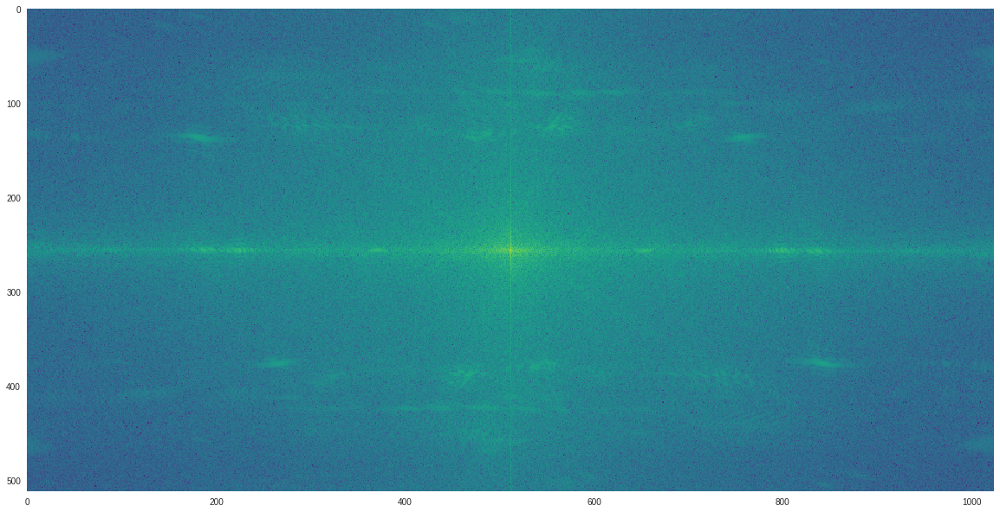

In [ ]:
plt.imshow(np.log10(1+np.absolute(imFFTcentre)),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

In [ ]:
imFFT[2**5:-2**5,:]=0

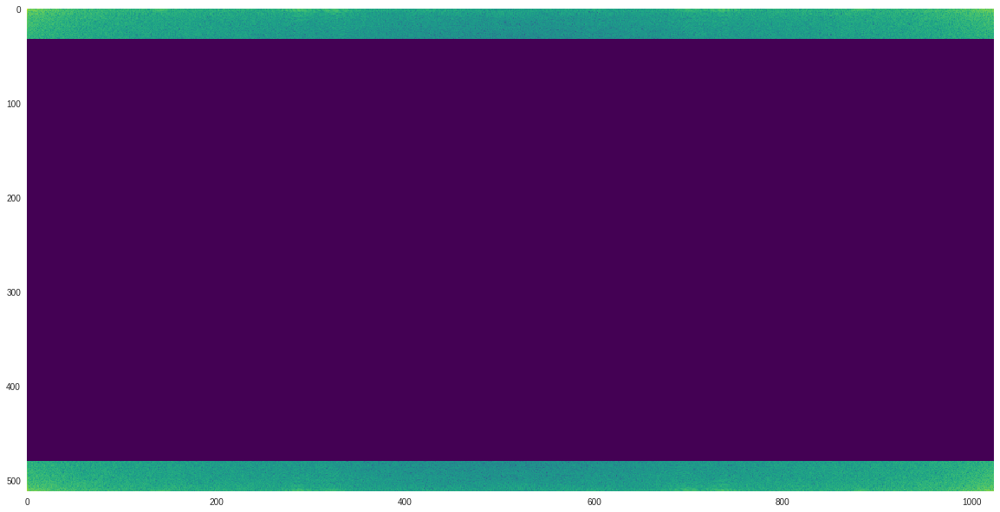

In [ ]:
plt.imshow(np.log10(1+np.absolute(imFFT)),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

In [ ]:
def invFFT2D(imageFFT):
  L,H = imageFFT.shape 
  Imfiltre = []
  for ligne in imageFFT :
    Imfiltre.append(FFTinv(ligne,H,H))
  Imfiltre = np.transpose(np.array(Imfiltre))
  Imfiltre2 = []
  for col in Imfiltre :
    Imfiltre2.append(FFTinv(col,L,L))
  Imfiltre2 = np.transpose(np.array(Imfiltre2))
  return Imfiltre2

In [ ]:
Imfiltre = invFFT2D(imFFT)

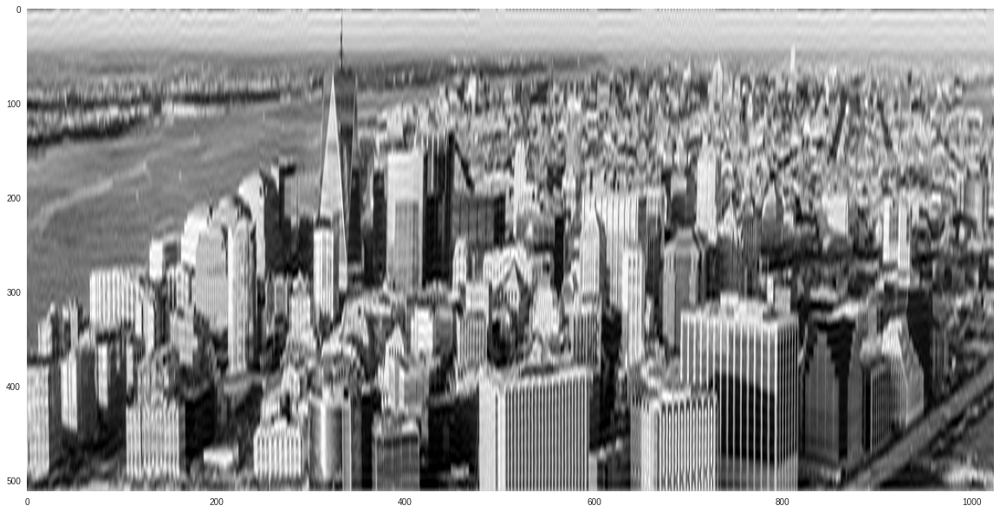

In [ ]:
plt.imshow(Imfiltre.real, cmap='gray', vmin=0, vmax=255)
plt.grid(None)

---

In [ ]:
import matplotlib.pyplot as plt
plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = (20, 20)

In [ ]:
L = 2**9
H = 2**8
l = 31
h = 11
image = np.zeros((H,L))
carre = np.ones((h,l))
image[H//2-h//2:H//2+h//2+1,L//2-l//2:L//2+l//2+1] = carre

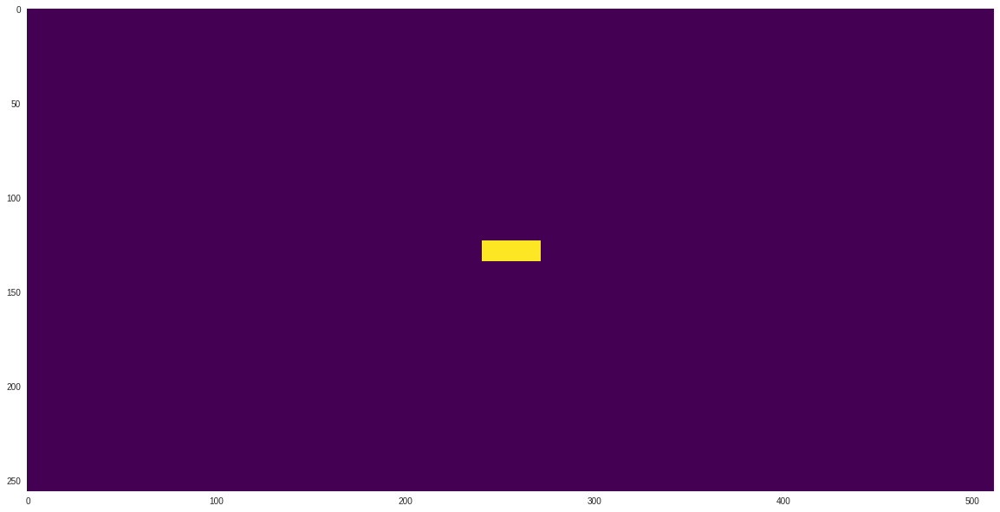

In [ ]:
plt.imshow(image,cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

In [ ]:
imfft,imfftcentre = FFT2D(image)

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
colors = [(0, 0, 0), (1, 0, 0)] 
rouges = LinearSegmentedColormap.from_list("Custom", colors, N=100)

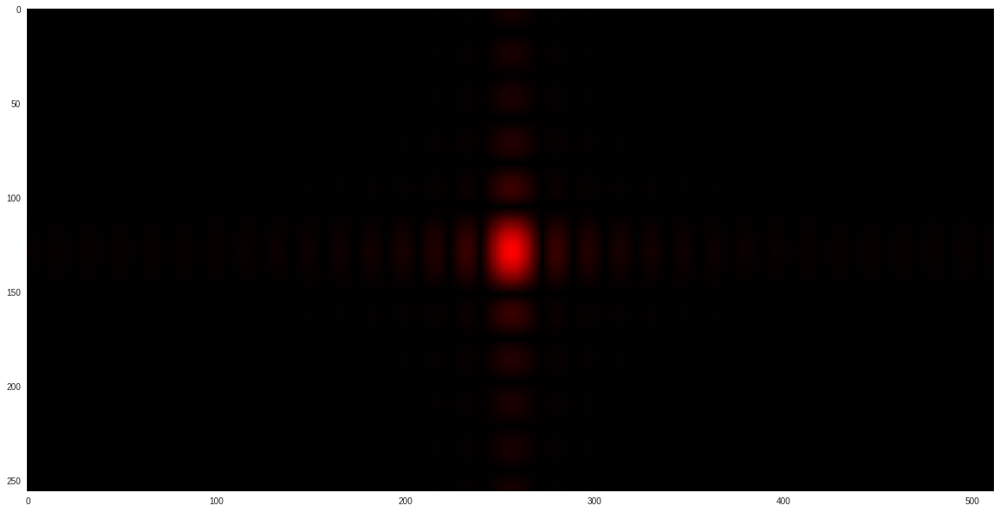

In [ ]:
plt.imshow(np.absolute(imfftcentre),cmap=rouges, interpolation='nearest')
plt.grid(None)

In [ ]:
L = 2**8
H = 2**7
l = 31
h = 11
grille = np.zeros((H,L))
for i in range(H) :
  if 0<i%5<2 :
    grille[i,:] = 1
for j in range(L) :
  if 0<j%10<2 :
    grille[:,j] = 1

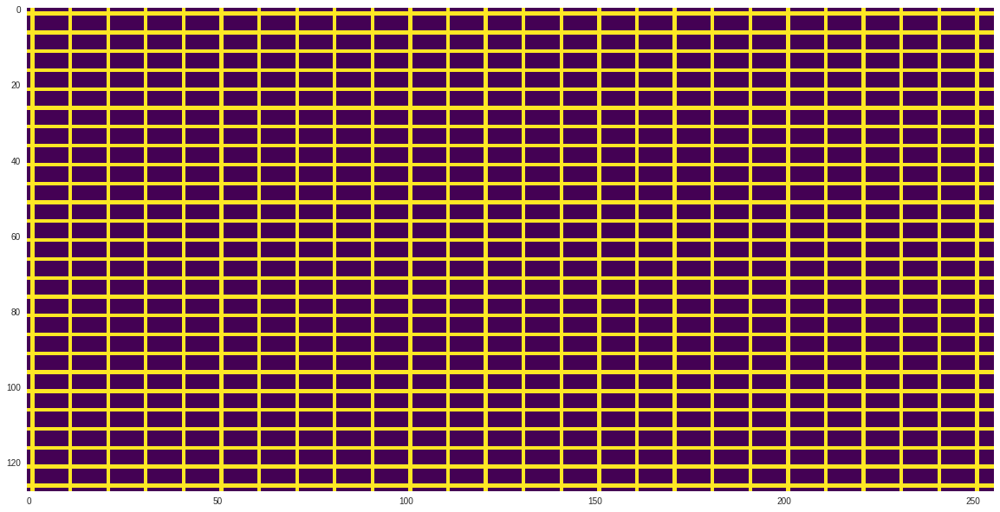

In [ ]:
plt.imshow(grille,cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

In [ ]:
imfft,imfftcentre = FFT2D(grille)

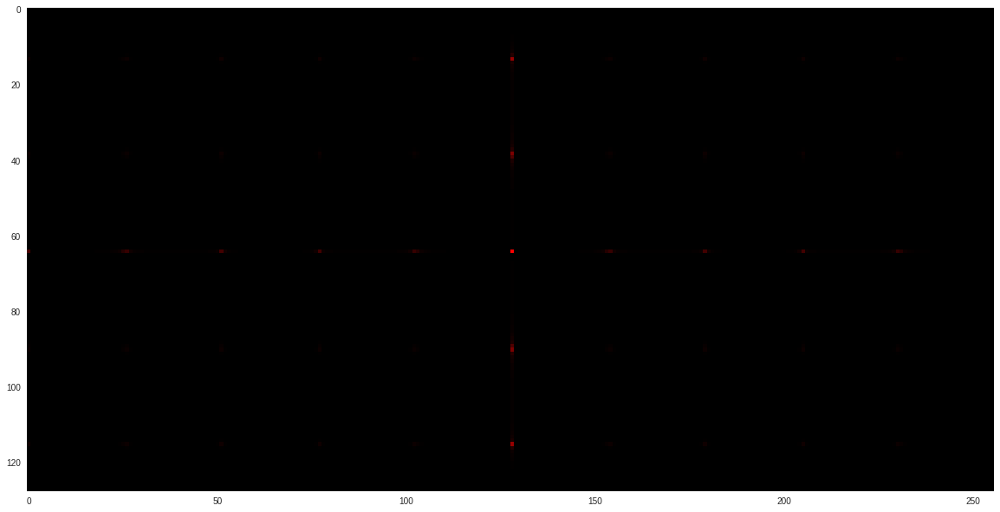

In [ ]:
plt.imshow(np.absolute(imfftcentre),cmap=rouges, interpolation='nearest')
plt.grid(None)

In [ ]:
imfftcentre[:,L//2-3:L//2+3]=0

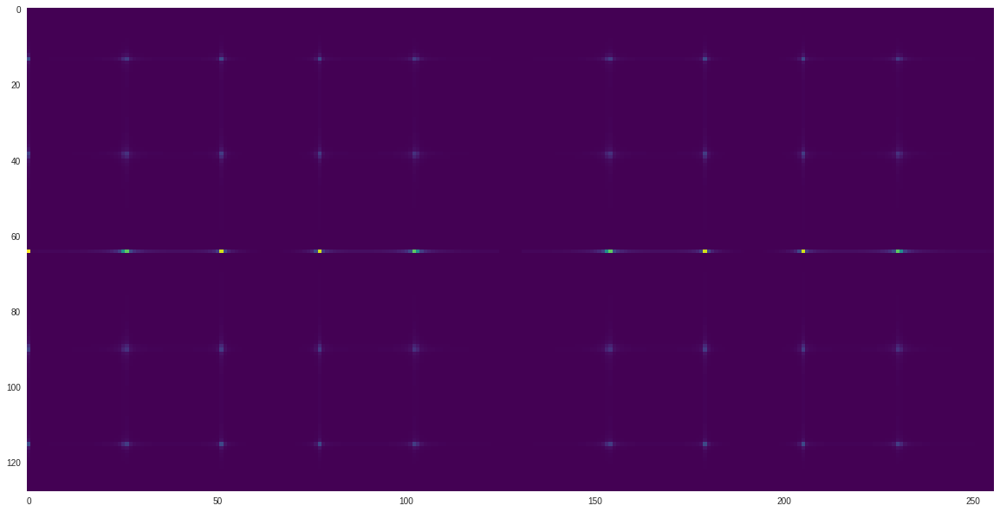

In [ ]:
plt.imshow(np.absolute(imfftcentre),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

In [ ]:
imfiltre = invFFT2D(imfftcentre)

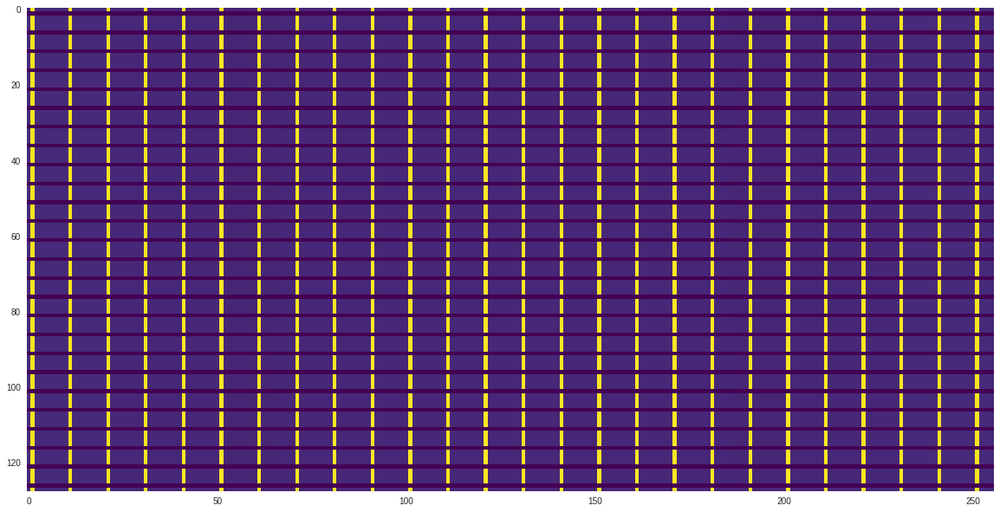

In [ ]:
plt.imshow(np.absolute(imfiltre),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

In [ ]:
imFFT[:,4:-4]=0

##### Application d'un flou gaussien :

In [ ]:
import numpy as np

def gaussienne(x,x0,sigma):
  return np.exp(-(x-x0)**2/(2*sigma**2))

def gaussienne2D(x,y,x0,y0,sigma):
  return gaussienne(x,x0,sigma)*gaussienne(y,y0,sigma)

a = 5

K = [[int(255*gaussienne2D(i,j,a//2,a//2,2)) for i in range(a)] for j in range(a)]
K = np.array(K)
K = K/np.sum(K)*a**2

In [ ]:
L = 2**8
H = 2**7
l = 31
h = 11
grille = np.zeros((H,L))
for i in range(H) :
  if 0<i%(2**4)+1<4 :
    grille[i,:] = 1
for j in range(L) :
  if 0<j%(2**4)+1<4 :
    grille[:,j] = 1

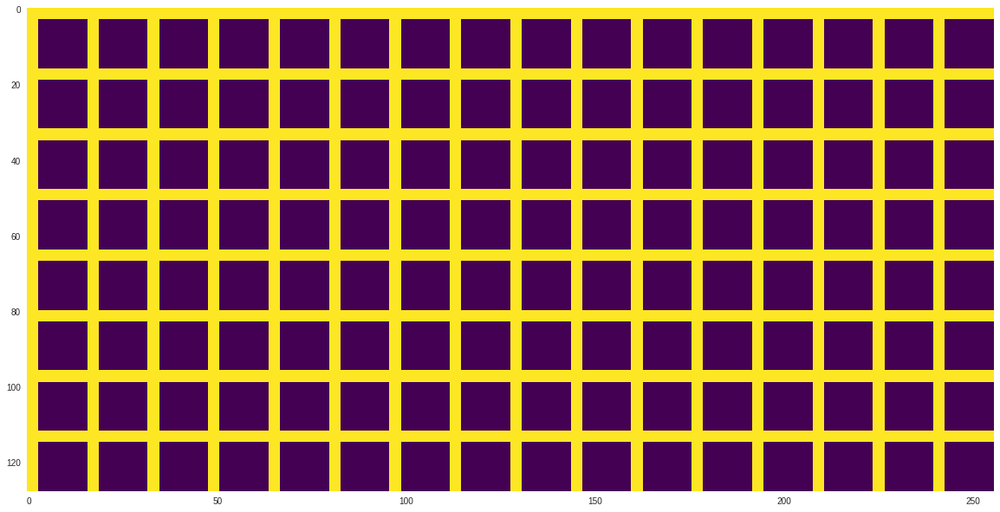

In [ ]:
plt.imshow(grille,cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

Convolution :

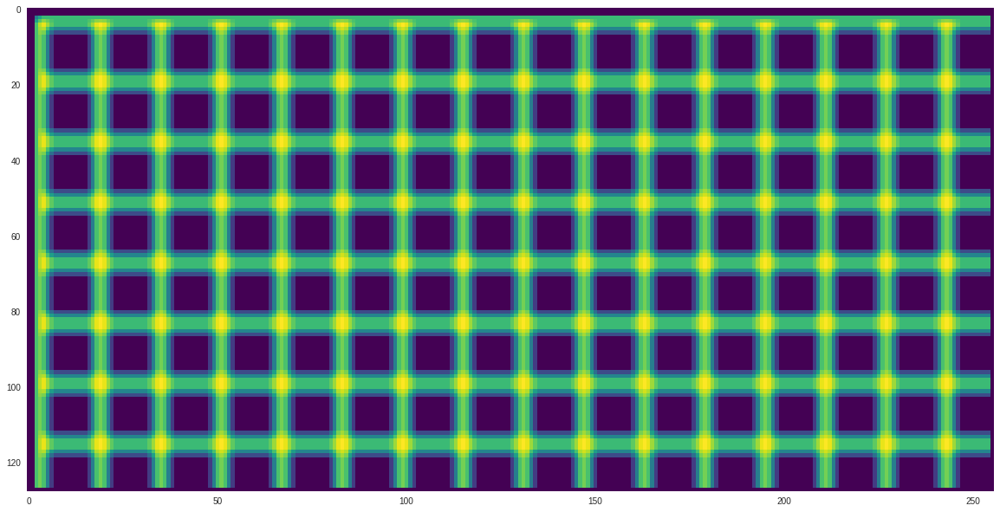

In [ ]:
# on commence par un padding de l'image

grillepad = np.pad(grille, a//2, mode='constant', constant_values=0)
grillepadflou = np.zeros((H,L))
for i in range(a//2,H-a//2+1):
  for j in range(a//2,L-a//2+1):
    grillepadflou[i,j]=np.sum(grillepad[i-a//2:i+a//2+1,j-a//2:j+a//2+1]@K)

plt.imshow(grillepadflou,cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

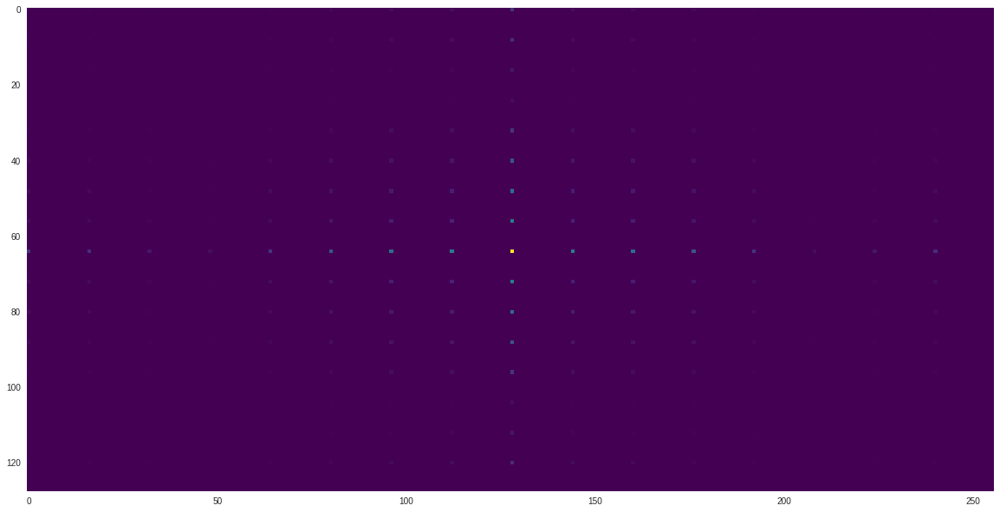

In [ ]:
imfftGrille,imfftcentreGrille = FFT2D(grille)
plt.imshow(np.absolute(imfftcentreGrille),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

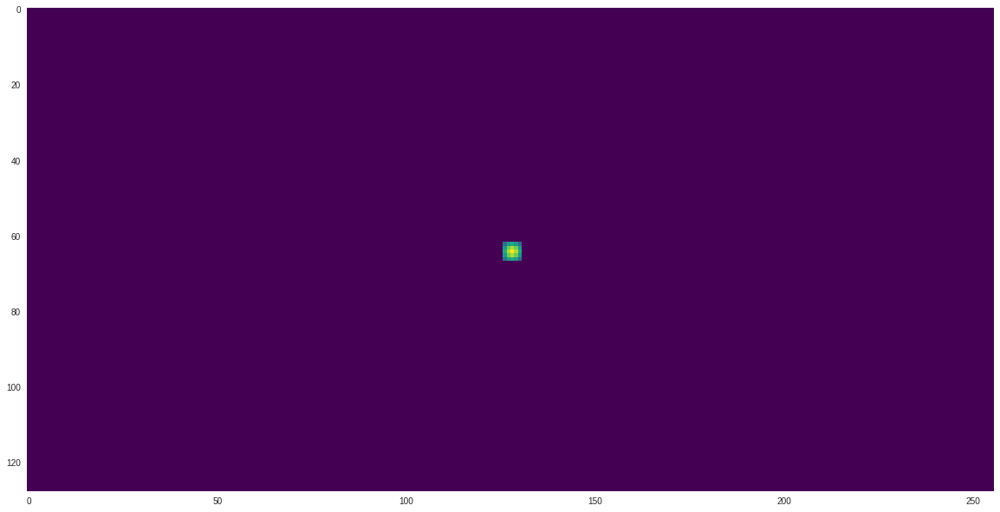

In [ ]:
flou = np.zeros((H,L))
flou[H//2-a//2:H//2+a//2+1,L//2-a//2:L//2+a//2+1] = K
plt.imshow(flou,cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

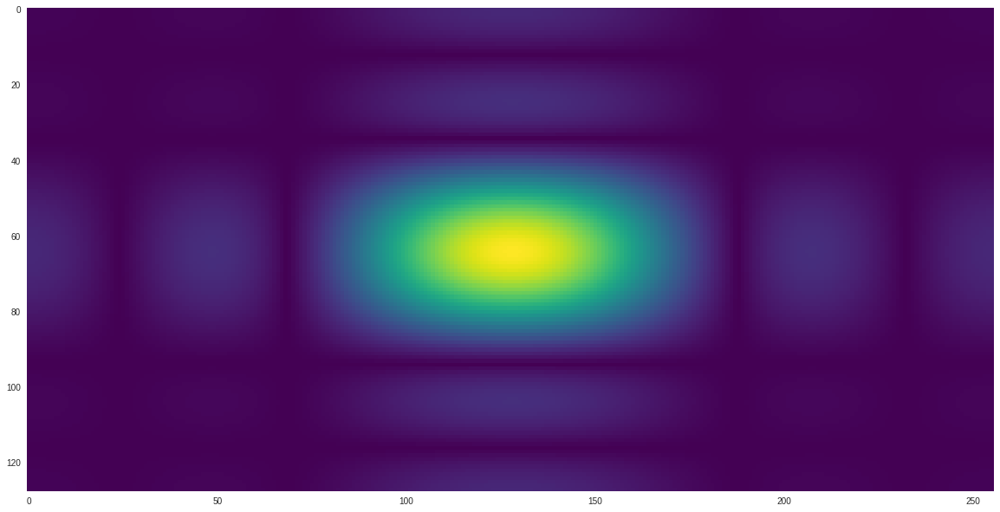

In [ ]:
imfftFlou,imfftcentreFlou = FFT2D(flou)
plt.imshow(np.absolute(imfftcentreFlou),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

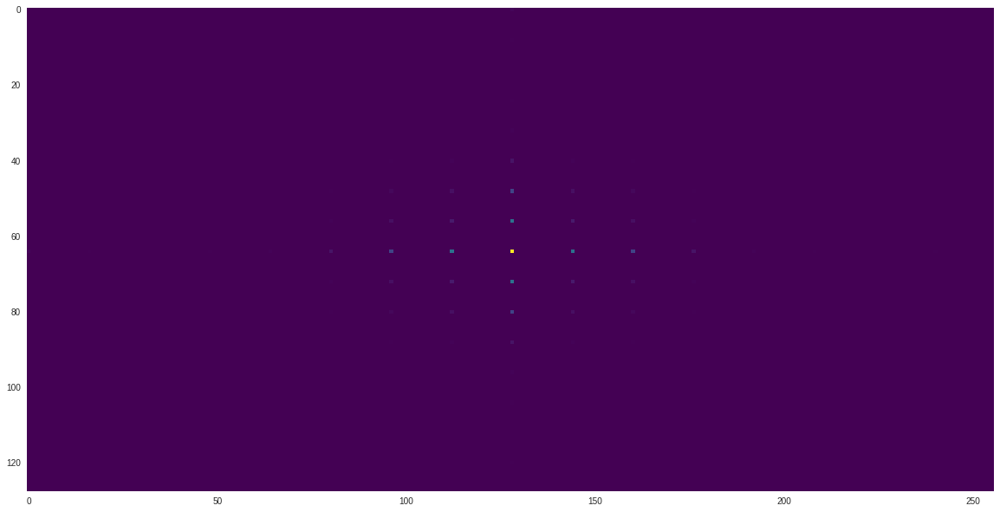

In [ ]:
grilleFlouFFT = imfftcentreGrille * imfftcentreFlou
plt.imshow(np.absolute(grilleFlouFFT),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

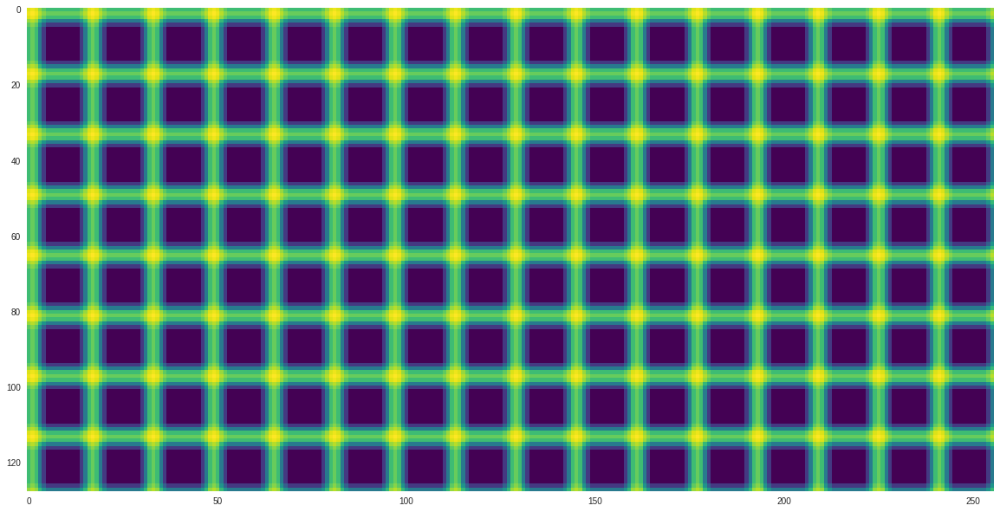

In [ ]:
grilleFlou = invFFT2D(grilleFlouFFT)
plt.imshow(np.absolute(grilleFlou),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

Avec photo :

In [ ]:
a = 9
K = [[int(255*gaussienne2D(i,j,a//2,a//2,a/6)) for i in range(a)] for j in range(a)]
K = np.array(K)
K = K/np.sum(K)

In [ ]:
K

array([[0.        , 0.        , 0.00056513, 0.00141283, 0.00197796,
        0.00141283, 0.00056513, 0.        , 0.        ],
       [0.        , 0.00113026, 0.00395592, 0.00762927, 0.00960723,
        0.00762927, 0.00395592, 0.00113026, 0.        ],
       [0.00056513, 0.00395592, 0.01215032, 0.02345295, 0.02938683,
        0.02345295, 0.01215032, 0.00395592, 0.00056513],
       [0.00141283, 0.00762927, 0.02345295, 0.04605821, 0.0576434 ,
        0.04605821, 0.02345295, 0.00762927, 0.00141283],
       [0.00197796, 0.00960723, 0.02938683, 0.0576434 , 0.07205425,
        0.0576434 , 0.02938683, 0.00960723, 0.00197796],
       [0.00141283, 0.00762927, 0.02345295, 0.04605821, 0.0576434 ,
        0.04605821, 0.02345295, 0.00762927, 0.00141283],
       [0.00056513, 0.00395592, 0.01215032, 0.02345295, 0.02938683,
        0.02345295, 0.01215032, 0.00395592, 0.00056513],
       [0.        , 0.00113026, 0.00395592, 0.00762927, 0.00960723,
        0.00762927, 0.00395592, 0.00113026, 0.        ],


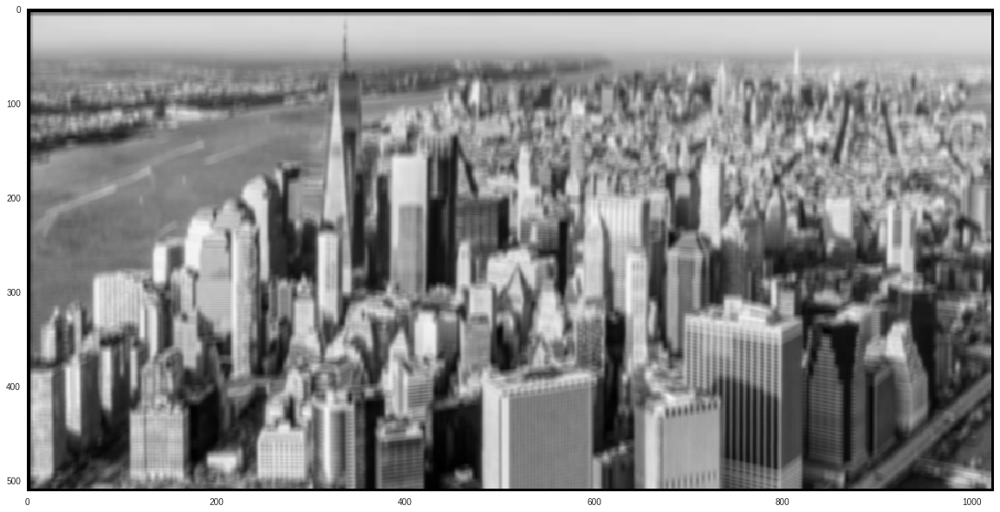

In [ ]:
image_pad = np.pad(image_np, a//2, mode='constant', constant_values=0)
image_floue = np.zeros((H,L))
for i in range(a//2,H-a//2+1):
  for j in range(a//2,L-a//2+1):
    image_floue[i,j]=np.sum(image_pad[i-a//2:i+a//2+1,j-a//2:j+a//2+1]@K)

plt.imshow(image_floue/a, cmap='gray', vmin=0, vmax=255, interpolation='nearest')
plt.grid(None)

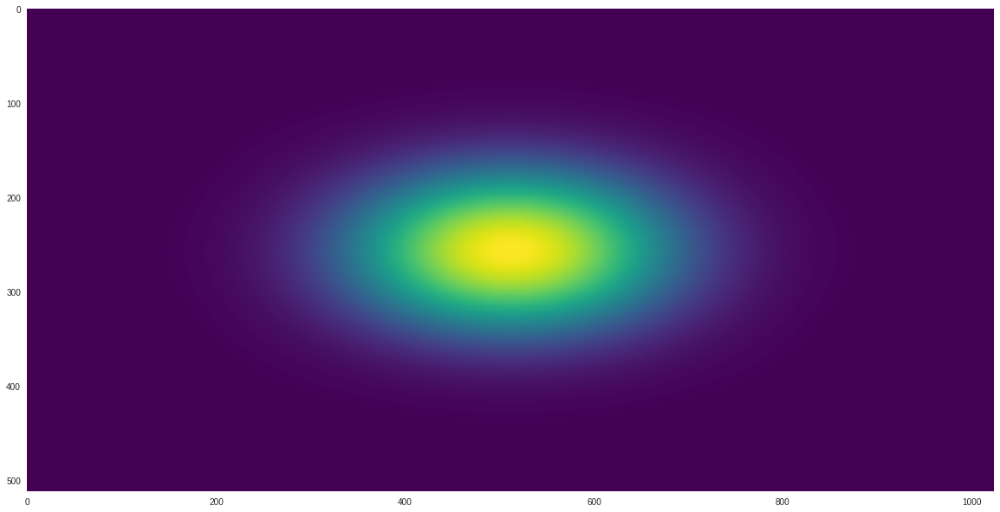

In [ ]:
H,L = image_np.shape
flou = np.zeros((H,L))
flou[H//2-a//2:H//2+a//2+1,L//2-a//2:L//2+a//2+1] = K
imfftFlou,imfftcentreFlou = FFT2D(flou)
plt.imshow(np.log10(1+np.absolute(imfftcentreFlou)),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

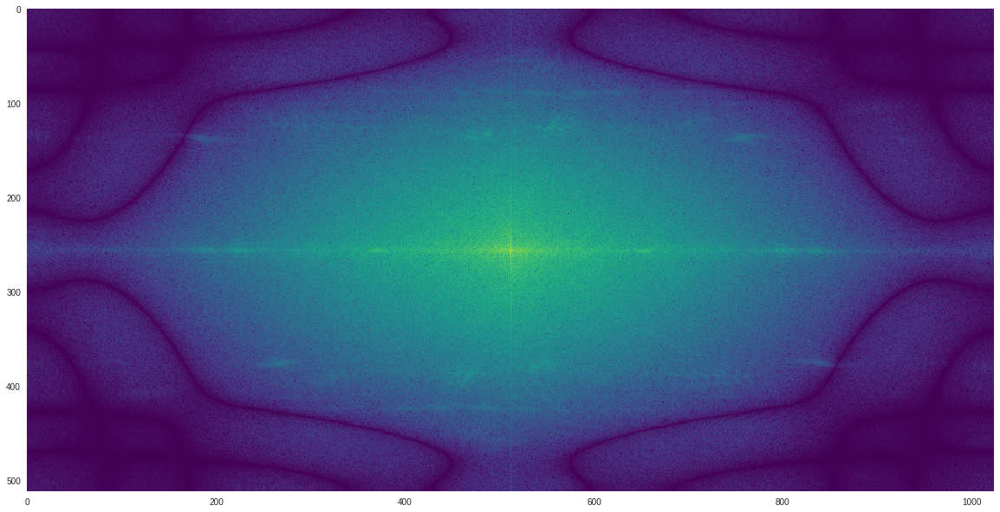

In [ ]:
imfft,imfftcentre = FFT2D(image_np)
imageFlouFFT = imfftcentre * imfftcentreFlou
plt.imshow(np.log10(1+np.absolute(imageFlouFFT)),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

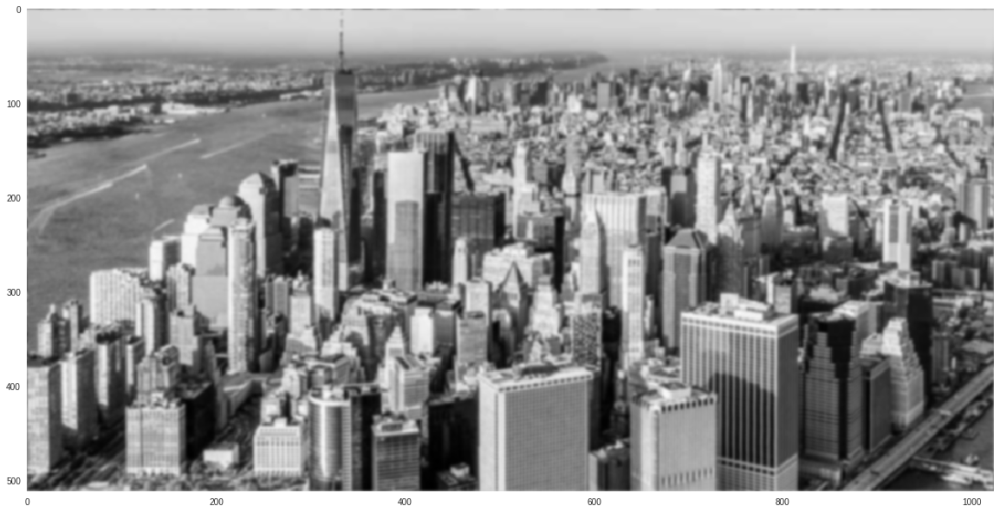

In [ ]:
imageFlou = invFFT2D(imageFlouFFT)
plt.imshow(np.absolute(centrage(imageFlou)), cmap='gray', vmin=0, vmax=255, interpolation='nearest')
plt.grid(None)

##### Détramage

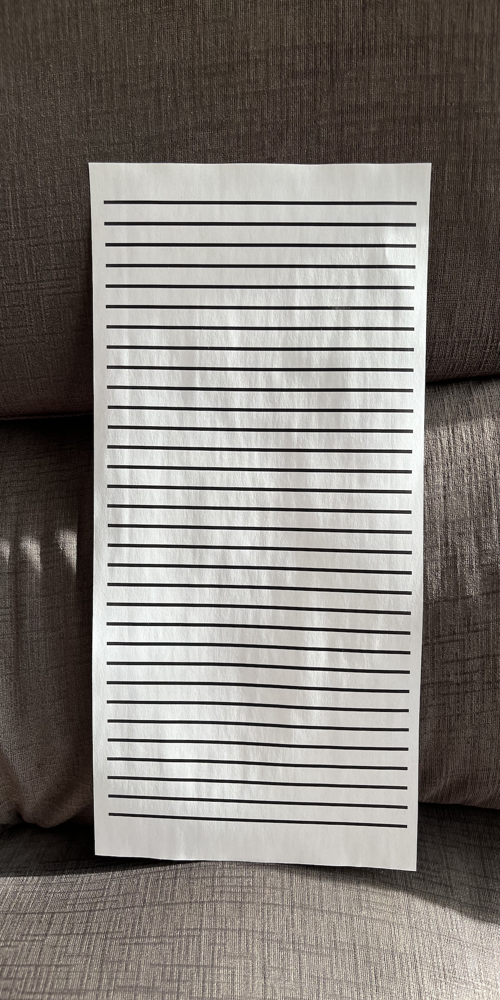

In [ ]:
image = Image.open('imagefft.png')
image

In [ ]:
imageG = image.convert("L")
image_np = np.array(imageG)

In [ ]:
H,L = image_np.shape
print(H,L)

2048 1024


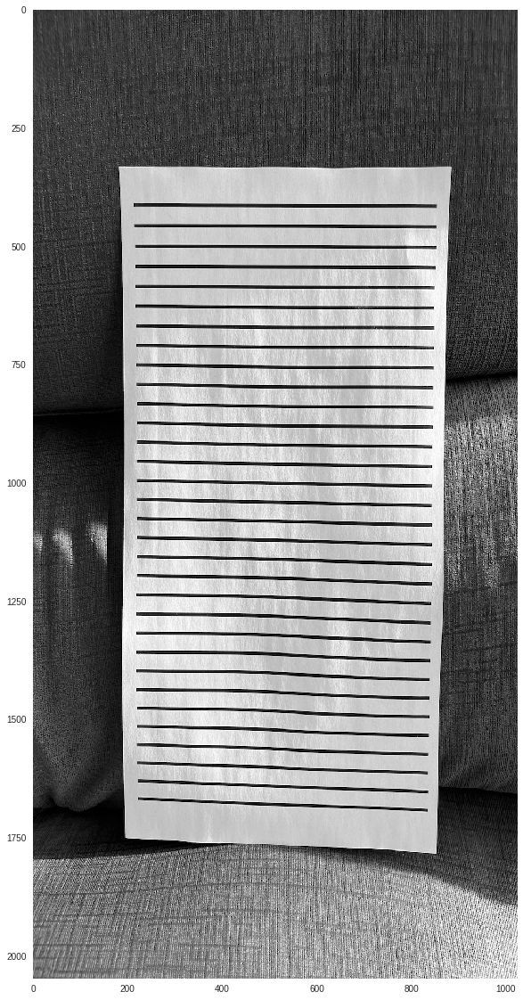

In [ ]:
plt.imshow(np.absolute(image_np), cmap='gray', vmin=0, vmax=255, interpolation='nearest')
plt.grid(None)

In [ ]:
imfft,imfftcentre = FFT2D(image_np) # 47 s

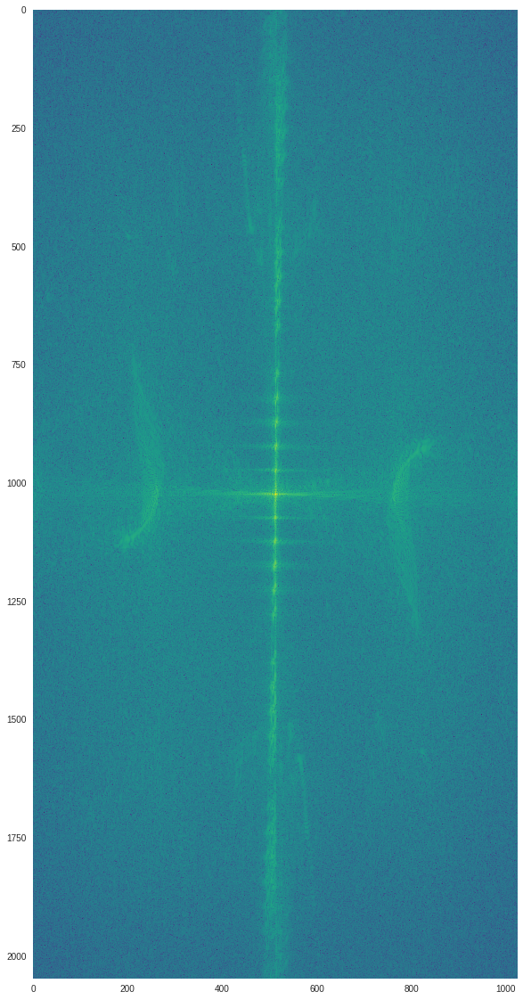

In [ ]:
plt.imshow(np.log10(1+np.absolute(imfftcentre)),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

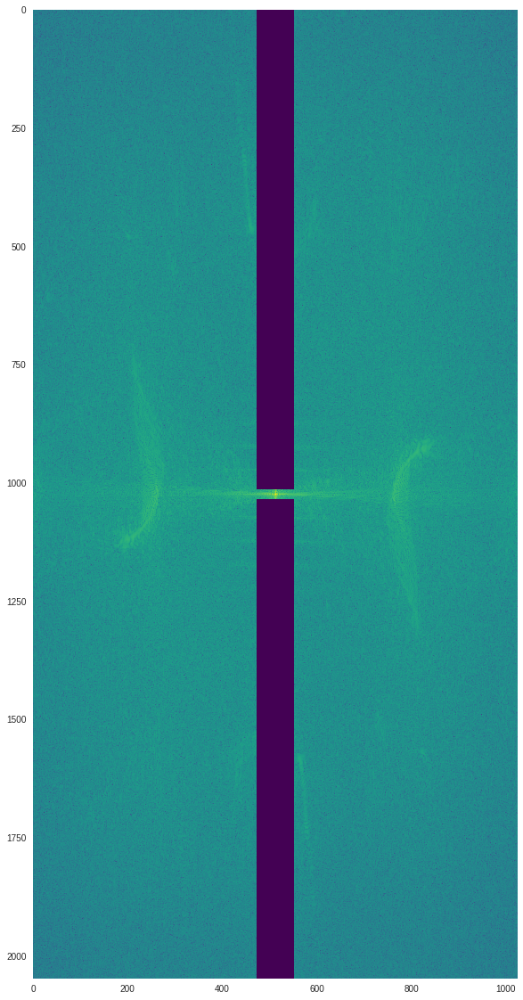

In [ ]:
fftfiltre = np.copy(imfftcentre)
pH = 50
pL = 0
s = 20
for i in range(H):
  for j in range(L):
    #if (((i-H//2)%pH)*1)**2+((j-L//2)/1)**2 < s**2 and ((i-H//2)*1)**2+((j-L//2)/1)**2 > s**2 :#and abs(i-H//2) < 400:
      #fftfiltre[-i,j] = 0
      #fftfiltre[i,j] = 0
    if abs(j-L//2)<40 and abs(i-H//2)>10:
      fftfiltre[i,j] = 0
plt.imshow(np.log10(1+np.absolute(fftfiltre)),cmap=plt.cm.viridis, interpolation='nearest')
plt.grid(None)

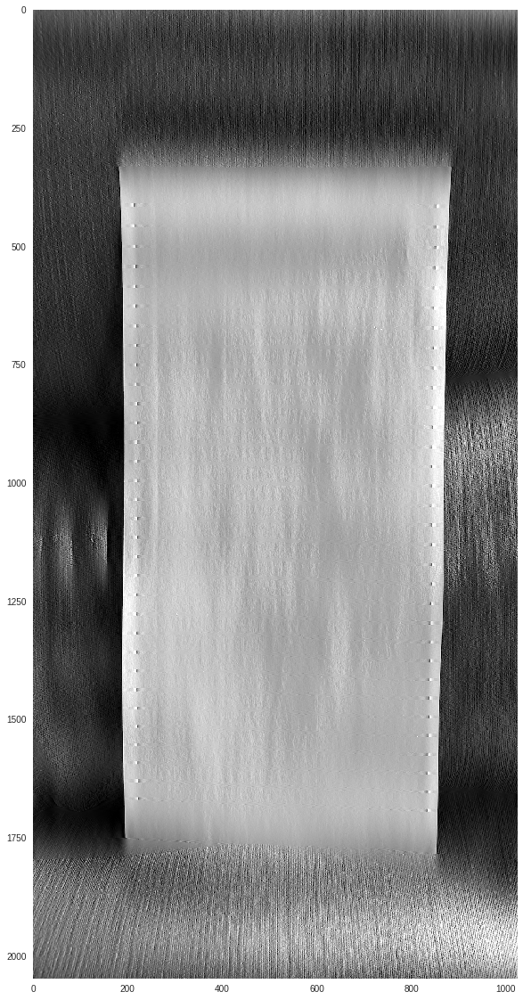

In [ ]:
imageFiltre = invFFT2D(fftfiltre) # 31s
plt.imshow(np.absolute(imageFiltre), cmap='gray', vmin=0, vmax=255, interpolation='nearest')
plt.grid(None)